In [1]:
!python3 dataset.py 	--test_content_dir './data/content' --test_style_dir './data/style'

|_ resizing
|__ Start Resizing ./data/content 
100%|█████████████████████████████████████████████| 5/5 [00:08<00:00,  1.64s/it]
|__ Start Resizing ./data/style 
100%|███████████████████████████████████████████| 13/13 [00:02<00:00,  6.30it/s]
|_ no resize needed resize


In [2]:
import os
import argparse
from PIL import Image
import torch
from torchvision import transforms
from torchvision.utils import save_image
from model import Model
import numpy as np 

import matplotlib.pyplot as plt


In [3]:
n_cluster = 7
alpha = 1
device = 'cpu'
lam = 0.1

style_dir_resized = './data/style_resized/'

style = 'in2.jpg'


In [4]:
trans = transforms.Compose([transforms.ToTensor()])

In [5]:
model = Model(n_cluster=n_cluster,
                alpha=alpha,
                device=device,
                lam=lam,
                max_cycles=None,
                print_tsne=False,
                print_cluster_criterium=False)

model.load_state_dict(torch.load("model_state.pth", map_location=lambda storage, loc: storage))
model = model.to(device)


In [6]:
c = Image.open(style_dir_resized+style)
s = Image.open(style_dir_resized+style)


c_tensor = trans(c).unsqueeze(0).to(device)
s_tensor = trans(s).unsqueeze(0).to(device)

with torch.no_grad():
    out = model.generate(c_tensor, s_tensor, print_tsne=False, print_cluster_criterium=False)


mse = ((c_tensor-out[:,:,:c_tensor.shape[-2],:c_tensor.shape[-1]])**2).mean()




/home/alvarosca/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


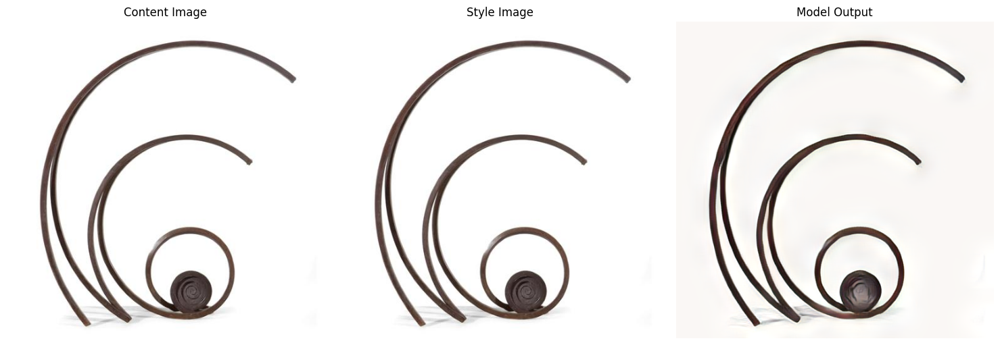

In [7]:
# Create a figure and a set of subplots
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the first image
axes[0].imshow(c)
axes[0].set_title('Content Image')
axes[0].axis('off')

# Plot the second image
axes[1].imshow(s)
axes[1].set_title('Style Image')
axes[1].axis('off')

# Plot the third image
axes[2].imshow(out.squeeze().cpu().detach().numpy().transpose(1, 2, 0))
axes[2].set_title('Model Output')
axes[2].axis('off')

# Adjust layout
plt.tight_layout()

# Show plot
plt.show()

In [8]:
mse = []
n_clusters = []

max_n_cluster = 10

for n_cluster in range(1,max_n_cluster+1):
    model = Model(n_cluster=n_cluster,
                    alpha=alpha,
                    device=device,
                    lam=lam,
                    max_cycles=None)

    model.load_state_dict(torch.load("model_state.pth", map_location=lambda storage, loc: storage))
    model = model.to(device)

    c = Image.open(style_dir_resized+style)
    s = Image.open(style_dir_resized+style)


    c_tensor = trans(c).unsqueeze(0).to(device)
    s_tensor = trans(s).unsqueeze(0).to(device)

    with torch.no_grad():
        out = model.generate(c_tensor, s_tensor, print_tsne=False, print_cluster_criterium=False)


    mse.append(((c_tensor-out[:,:,:c_tensor.shape[-2],:c_tensor.shape[-1]])**2).mean())
    n_clusters.append(n_cluster)

    print(mse[-1])



/home/alvarosca/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


tensor(0.0038)


/home/alvarosca/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


tensor(0.0028)


/home/alvarosca/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


tensor(0.0031)


/home/alvarosca/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


tensor(0.0032)


/home/alvarosca/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


tensor(0.0035)


/home/alvarosca/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


tensor(0.0036)


/home/alvarosca/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


tensor(0.0033)


/home/alvarosca/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


tensor(0.0037)


/home/alvarosca/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


tensor(0.0036)


/home/alvarosca/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


tensor(0.0037)


/home/alvarosca/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


tensor(0.0037)


/home/alvarosca/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


tensor(0.0037)


/home/alvarosca/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


tensor(0.0037)


/home/alvarosca/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


tensor(0.0044)


/home/alvarosca/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


tensor(0.0041)


/home/alvarosca/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


tensor(0.0042)


/home/alvarosca/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


tensor(0.0041)


/home/alvarosca/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


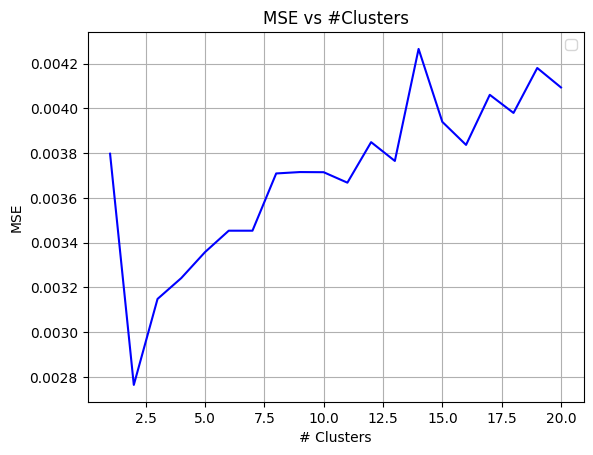

In [ ]:
mse = np.array(mse)
n_clusters  = np.array(n_clusters)


# Create the plot
plt.plot(n_clusters, mse, color='blue', linestyle='-')

# Add labels and title
plt.xlabel('# Clusters')
plt.ylabel('MSE')
plt.title('MSE vs #Clusters')

# Add grid
plt.grid(True)

# Add legend
plt.legend()

# Show plot
plt.show()

In [ ]:
n_cluster = 2
alpha = 1
device = 'cpu'
lam = 0.1


style_dir_resized = './data/style_resized/'
content_dir_resized = './data/content_resized/'

content = 'avril.jpg'
style = 'in2.jpg'


c = Image.open(content_dir_resized+content)
s = Image.open(style_dir_resized+style)


c_tensor = trans(c).unsqueeze(0).to(device)
s_tensor = trans(s).unsqueeze(0).to(device)

with torch.no_grad():
    out = model.generate(c_tensor, s_tensor, print_tsne=False, print_cluster_criterium=False)





/home/alvarosca/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


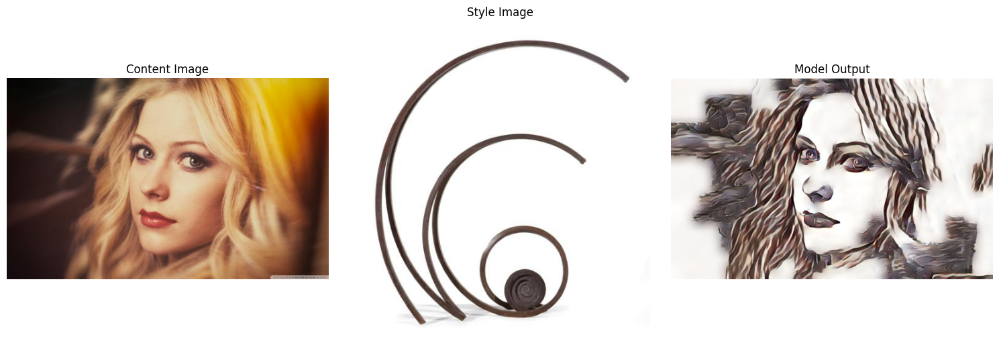

In [ ]:
# Create a figure and a set of subplots
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the first image
axes[0].imshow(c)
axes[0].set_title('Content Image')
axes[0].axis('off')

# Plot the second image
axes[1].imshow(s)
axes[1].set_title('Style Image')
axes[1].axis('off')

# Plot the third image
axes[2].imshow(out.squeeze().cpu().detach().numpy().transpose(1, 2, 0))
axes[2].set_title('Model Output')
axes[2].axis('off')

# Adjust layout
plt.tight_layout()

# Show plot
plt.show()

In [ ]:

alpha = 1
device = 'cpu'
lam = 0.1


style_dir_resized = './data/style_resized/'
content_dir_resized = './data/content_resized/'

content = 'avril.jpg'
style = 'in2.jpg'


images = []
n_clusters = []

for n_cluster in range(1,11):

    model = Model(n_cluster=n_cluster,
                    alpha=alpha,
                    device=device,
                    lam=lam,
                    max_cycles=None)

    model.load_state_dict(torch.load("model_state.pth", map_location=lambda storage, loc: storage))
    model = model.to(device)

    c = Image.open(content_dir_resized+content)
    s = Image.open(style_dir_resized+style)

    c_tensor = trans(c).unsqueeze(0).to(device)
    s_tensor = trans(s).unsqueeze(0).to(device)

    with torch.no_grad():
        out = model.generate(c_tensor, s_tensor, print_tsne=False, print_cluster_criterium=False)

    images.append(out.squeeze().cpu().detach().numpy().transpose(1, 2, 0))
    n_clusters.append(n_cluster)



/home/alvarosca/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/alvarosca/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/alvarosca/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/alvarosca/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/alvarosca/.loc

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

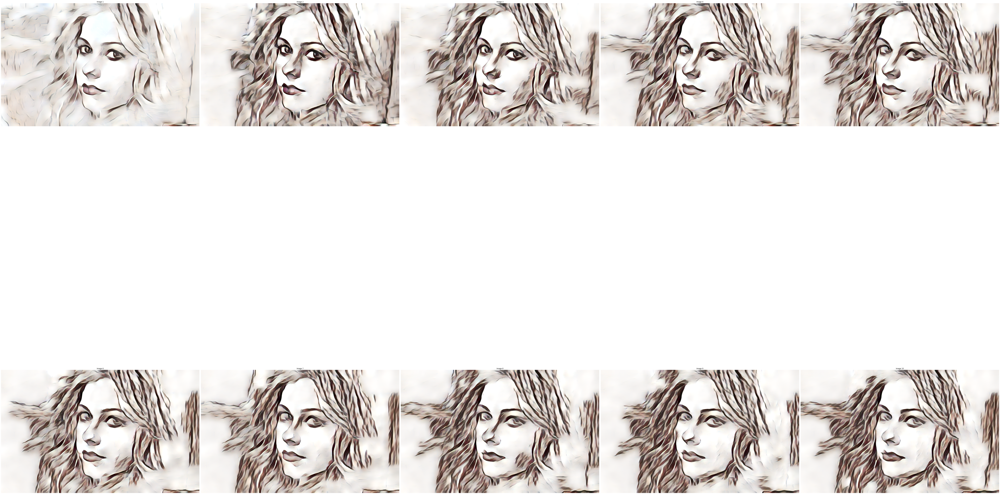

In [ ]:
# Create a figure and a set of subplots
fig, axes = plt.subplots(2, 5, figsize=(100, 100))

# Flatten the axes array for easier iteration
axes = axes.flatten()

# Plot each image
for i, image in enumerate(images):
    axes[i].imshow(image, cmap='gray')  # assuming grayscale images
    axes[i].set_title(f'Image {i+1}')
    axes[i].axis('off')

# Adjust layout
plt.tight_layout()

# Show plot
plt.show()